In [1]:
import os
os.environ["OMP_NUM_THREADS"] = "1" # export OMP_NUM_THREADS=1
os.environ["OPENBLAS_NUM_THREADS"] = "1" # export OPENBLAS_NUM_THREADS=1
os.environ["MKL_NUM_THREADS"] = "1" # export MKL_NUM_THREADS=1
os.environ["VECLIB_MAXIMUM_THREADS"] = "1" # export VECLIB_MAXIMUM_THREADS=1
os.environ["NUMEXPR_NUM_THREADS"] = "1" # export NUMEXPR_NUM_THREADS=1
os.environ["CUDA_VISIBLE_DEVICES"]= '3'
# os.environ["XLA_PYTHON_CLIENT_MEM_FRACTION"]=".45"
os.environ["XLA_PYTHON_CLIENT_ALLOCATOR"]="platform"

import numpy as np
import matplotlib.pyplot as plt
import multisite.fitting as fitting
import multisite.closed_loop as cl
import multisite.multielec_utils as mutils
import multiprocessing as mp
import statsmodels.api as sm
from copy import deepcopy, copy
from mpl_toolkits.mplot3d import Axes3D

%matplotlib inline
%load_ext autoreload
%autoreload 2

In [2]:
DATASET = "2020-10-18-0"
params_true = np.load(f'/Volumes/Lab/Users/praful/multielectrode/scripts/jupyter_notebooks/params_true_{DATASET}.npy', 
                      allow_pickle=True)

NUM_CELLS = params_true.shape[0]
NUM_PATTERNS = params_true.shape[1]

amps_scan = np.array([np.array(np.meshgrid(np.linspace(-2, 2, 21), 
                                np.linspace(-2, 2, 21),
                                np.linspace(-2, 2, 21))).T.reshape(-1,3)] * NUM_PATTERNS)

probs_true_scan = np.zeros((NUM_CELLS, NUM_PATTERNS, amps_scan.shape[1]))

cell_cnt = 0
for i in range(len(probs_true_scan)):
    for j in range(len(probs_true_scan[i])):
        if type(params_true[i][j]) != int:
            cell_cnt += 1
            probs_true_scan[i][j] = fitting.sigmoidND_nonlinear(
                                    sm.add_constant(amps_scan[j], has_constant='add'), 
                                    params_true[i][j])
        else:
            probs_true_scan[i][j] = np.zeros(amps_scan.shape[1])

print(cell_cnt)

11


In [ ]:
# CHECK DATASET IF NEEDED
from mpl_toolkits.mplot3d import Axes3D

for i in range(len(probs_true_scan)):
    for j in range(len(probs_true_scan[i])):
        if type(params_true[i][j]) != int:

            print(params_true[i][j])
            
            fig = plt.figure(0)
            fig.clear()
            ax = Axes3D(fig, auto_add_to_figure=False)
            fig.add_axes(ax)
            plt.xlabel(r'$I_1$ ($\mu$A)', fontsize=16)
            plt.ylabel(r'$I_2$ ($\mu$A)', fontsize=16)
            plt.xlim(-2, 2)
            plt.ylim(-2, 2)
            ax.set_zlim(-2, 2)
            ax.set_zlabel(r'$I_3$ ($\mu$A)', fontsize=16)

            scat = ax.scatter(amps_scan[j][:, 0], 
                              amps_scan[j][:, 1],
                              amps_scan[j][:, 2], marker='o', 
                              c=probs_true_scan[i][j], s=20, alpha=0.8, vmin=0, vmax=1)
            plt.show()

            input()

Setting up data...
Generating input list...
Fitting dataset...
Calculating Jacobian...
Optimizing trials...
0
(DeviceArray(1309462.6, dtype=float32), DeviceArray(12502.086, dtype=float32), DeviceArray(1409610.2, dtype=float32), DeviceArray(100147.66, dtype=float32))
1
(DeviceArray(1206535.8, dtype=float32), DeviceArray(12797.292, dtype=float32), DeviceArray(1327969.6, dtype=float32), DeviceArray(121433.92, dtype=float32))
2
(DeviceArray(1122544.5, dtype=float32), DeviceArray(12710.729, dtype=float32), DeviceArray(1237736.6, dtype=float32), DeviceArray(115192.14, dtype=float32))
3
(DeviceArray(1052545.8, dtype=float32), DeviceArray(12461.367, dtype=float32), DeviceArray(1149757.4, dtype=float32), DeviceArray(97211.57, dtype=float32))
4
(DeviceArray(993352.7, dtype=float32), DeviceArray(12608.672, dtype=float32), DeviceArray(1101185.9, dtype=float32), DeviceArray(107833.195, dtype=float32))
5
(DeviceArray(942715.3, dtype=float32), DeviceArray(12562.568, dtype=float32), DeviceArray(104722

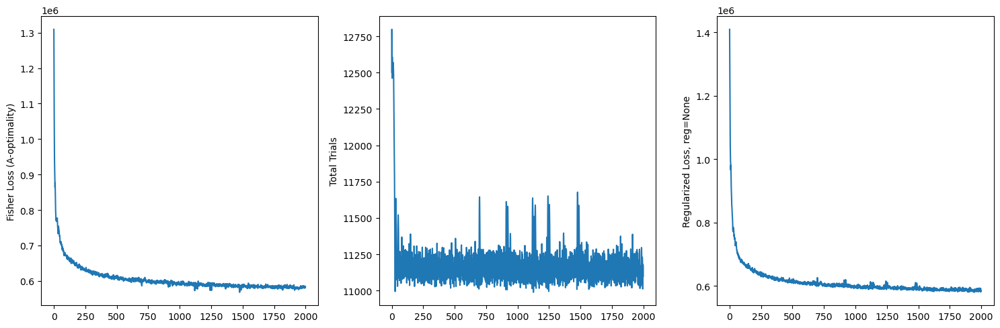

0.08631589387468439 0.08631589387468439


/tmp/ipykernel_68608/2421816399.py:117: RuntimeWarning: invalid value encountered in true_divide
  p_tmp = (p_new * T_new[np.newaxis, :, :] + probs_empirical * T_prev[np.newaxis, :, :]) / ((T_new + T_prev)[np.newaxis, :, :])


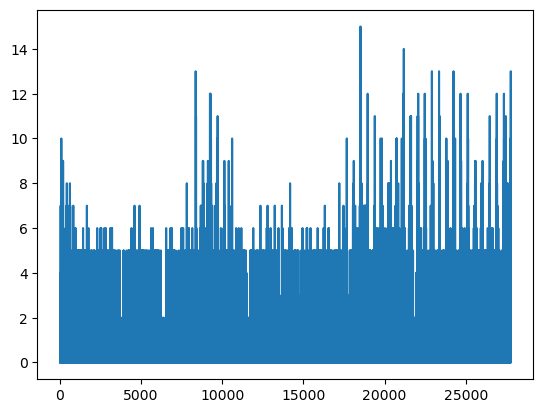

Setting up data...
Generating input list...
Fitting dataset...


/tmp/ipykernel_68608/2421816399.py:134: RuntimeWarning: invalid value encountered in true_divide
  p_tmp_uniform = (p_new_uniform * T_new_uniform[np.newaxis, :, :] + probs_empirical_uniform * T_prev_uniform[np.newaxis, :, :]) / ((T_prev_uniform + T_new_uniform)[np.newaxis, :, :])


Calculating Jacobian...
Optimizing trials...
0
(DeviceArray(132323.89, dtype=float32), DeviceArray(12502.086, dtype=float32), DeviceArray(141779.58, dtype=float32), DeviceArray(9455.682, dtype=float32))
1
(DeviceArray(129400.29, dtype=float32), DeviceArray(12705.762, dtype=float32), DeviceArray(140242.62, dtype=float32), DeviceArray(10842.328, dtype=float32))
2
(DeviceArray(126897.83, dtype=float32), DeviceArray(12498.047, dtype=float32), DeviceArray(136326.02, dtype=float32), DeviceArray(9428.184, dtype=float32))
3
(DeviceArray(124669.26, dtype=float32), DeviceArray(12116.934, dtype=float32), DeviceArray(131502.78, dtype=float32), DeviceArray(6833.524, dtype=float32))
4
(DeviceArray(122631.8, dtype=float32), DeviceArray(12166.261, dtype=float32), DeviceArray(129801.15, dtype=float32), DeviceArray(7169.348, dtype=float32))
5
(DeviceArray(120737.27, dtype=float32), DeviceArray(12028.098, dtype=float32), DeviceArray(126965.99, dtype=float32), DeviceArray(6228.719, dtype=float32))
6
(Devi

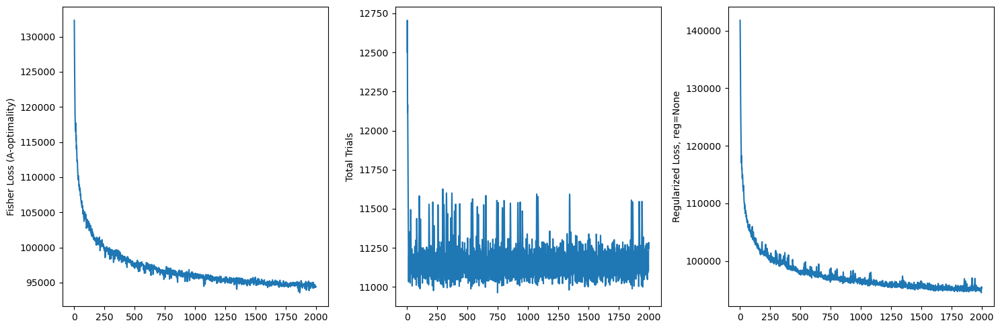

0.07240103301904223 0.07471505433394951


/tmp/ipykernel_68608/2421816399.py:117: RuntimeWarning: invalid value encountered in true_divide
  p_tmp = (p_new * T_new[np.newaxis, :, :] + probs_empirical * T_prev[np.newaxis, :, :]) / ((T_new + T_prev)[np.newaxis, :, :])


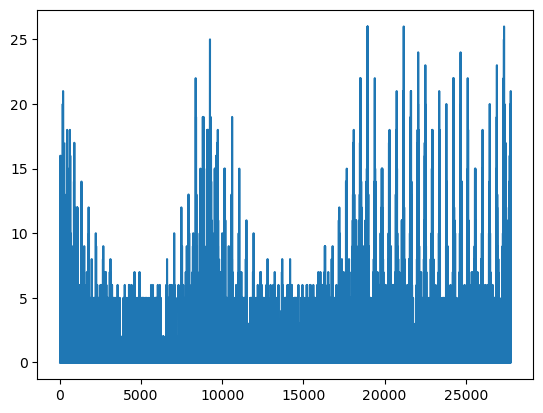

Setting up data...
Generating input list...
Fitting dataset...


/tmp/ipykernel_68608/2421816399.py:134: RuntimeWarning: invalid value encountered in true_divide
  p_tmp_uniform = (p_new_uniform * T_new_uniform[np.newaxis, :, :] + probs_empirical_uniform * T_prev_uniform[np.newaxis, :, :]) / ((T_prev_uniform + T_new_uniform)[np.newaxis, :, :])


Calculating Jacobian...
Optimizing trials...
0
(DeviceArray(78356.766, dtype=float32), DeviceArray(12502.086, dtype=float32), DeviceArray(83894.31, dtype=float32), DeviceArray(5537.549, dtype=float32))
1
(DeviceArray(77436.055, dtype=float32), DeviceArray(12654.097, dtype=float32), DeviceArray(83579.68, dtype=float32), DeviceArray(6143.6226, dtype=float32))
2
(DeviceArray(76722.55, dtype=float32), DeviceArray(12373.443, dtype=float32), DeviceArray(81747.195, dtype=float32), DeviceArray(5024.6455, dtype=float32))
3
(DeviceArray(76135.9, dtype=float32), DeviceArray(11908.113, dtype=float32), DeviceArray(79305.25, dtype=float32), DeviceArray(3169.3538, dtype=float32))
4
(DeviceArray(75626.22, dtype=float32), DeviceArray(11883.982, dtype=float32), DeviceArray(78699.36, dtype=float32), DeviceArray(3073.1428, dtype=float32))
5
(DeviceArray(75165.26, dtype=float32), DeviceArray(11668.796, dtype=float32), DeviceArray(77380.445, dtype=float32), DeviceArray(2215.1848, dtype=float32))
6
(DeviceAr

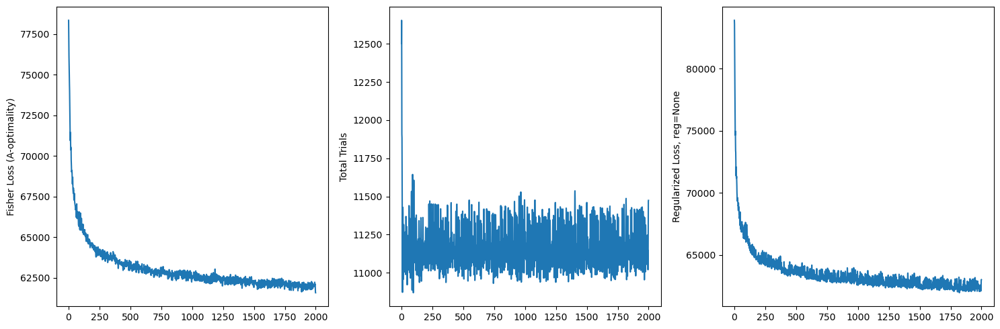

0.06886823081858752 0.07449020958584025


/tmp/ipykernel_68608/2421816399.py:117: RuntimeWarning: invalid value encountered in true_divide
  p_tmp = (p_new * T_new[np.newaxis, :, :] + probs_empirical * T_prev[np.newaxis, :, :]) / ((T_new + T_prev)[np.newaxis, :, :])


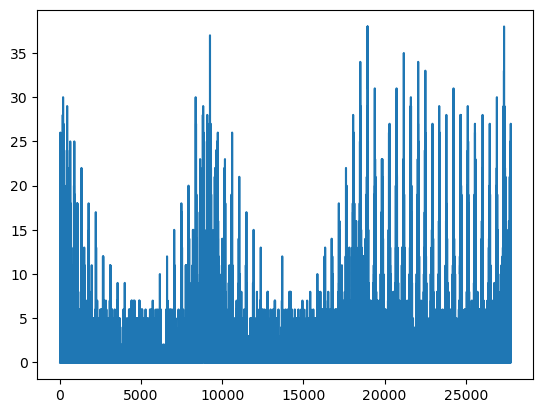

Setting up data...
Generating input list...
Fitting dataset...


/tmp/ipykernel_68608/2421816399.py:134: RuntimeWarning: invalid value encountered in true_divide
  p_tmp_uniform = (p_new_uniform * T_new_uniform[np.newaxis, :, :] + probs_empirical_uniform * T_prev_uniform[np.newaxis, :, :]) / ((T_prev_uniform + T_new_uniform)[np.newaxis, :, :])


Calculating Jacobian...
Optimizing trials...
0
(DeviceArray(56400.457, dtype=float32), DeviceArray(12502.086, dtype=float32), DeviceArray(60420.906, dtype=float32), DeviceArray(4020.4497, dtype=float32))
1
(DeviceArray(55352.168, dtype=float32), DeviceArray(12711.331, dtype=float32), DeviceArray(59978.324, dtype=float32), DeviceArray(4626.1577, dtype=float32))
2
(DeviceArray(54513.242, dtype=float32), DeviceArray(12498.314, dtype=float32), DeviceArray(58522.773, dtype=float32), DeviceArray(4009.5322, dtype=float32))
3
(DeviceArray(53808.363, dtype=float32), DeviceArray(12100.357, dtype=float32), DeviceArray(56665.918, dtype=float32), DeviceArray(2857.554, dtype=float32))
4
(DeviceArray(53250.54, dtype=float32), DeviceArray(12063.513, dtype=float32), DeviceArray(56001.438, dtype=float32), DeviceArray(2750.8984, dtype=float32))
5
(DeviceArray(53337.64, dtype=float32), DeviceArray(11818.256, dtype=float32), DeviceArray(55378.586, dtype=float32), DeviceArray(2040.946, dtype=float32))
6
(De

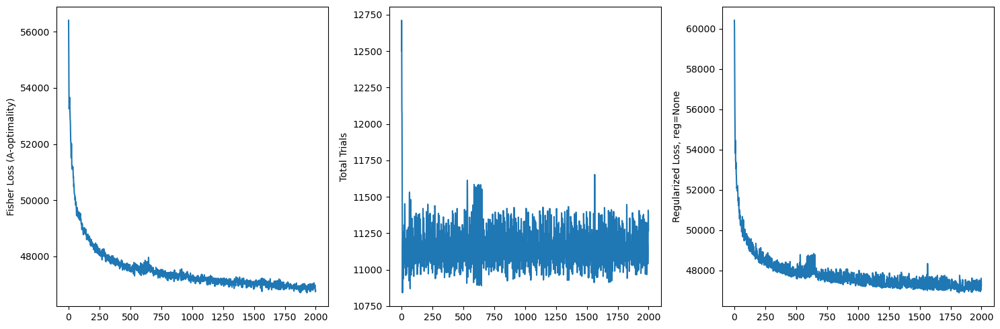

0.06670649274703562 0.07521459162447894


/tmp/ipykernel_68608/2421816399.py:117: RuntimeWarning: invalid value encountered in true_divide
  p_tmp = (p_new * T_new[np.newaxis, :, :] + probs_empirical * T_prev[np.newaxis, :, :]) / ((T_new + T_prev)[np.newaxis, :, :])


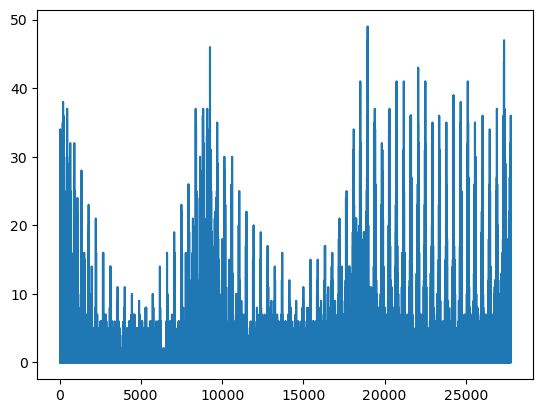

Setting up data...
Generating input list...
Fitting dataset...


/tmp/ipykernel_68608/2421816399.py:134: RuntimeWarning: invalid value encountered in true_divide
  p_tmp_uniform = (p_new_uniform * T_new_uniform[np.newaxis, :, :] + probs_empirical_uniform * T_prev_uniform[np.newaxis, :, :]) / ((T_prev_uniform + T_new_uniform)[np.newaxis, :, :])


Calculating Jacobian...
Optimizing trials...
0
(DeviceArray(73409.55, dtype=float32), DeviceArray(12502.086, dtype=float32), DeviceArray(78633.086, dtype=float32), DeviceArray(5223.541, dtype=float32))
1
(DeviceArray(72117.664, dtype=float32), DeviceArray(12685.556, dtype=float32), DeviceArray(78031.23, dtype=float32), DeviceArray(5913.563, dtype=float32))
2
(DeviceArray(71070.11, dtype=float32), DeviceArray(12442.242, dtype=float32), DeviceArray(76068.58, dtype=float32), DeviceArray(4998.471, dtype=float32))
3
(DeviceArray(70181.15, dtype=float32), DeviceArray(12014.249, dtype=float32), DeviceArray(73569.95, dtype=float32), DeviceArray(3388.8066, dtype=float32))
4
(DeviceArray(69402.67, dtype=float32), DeviceArray(11984.574, dtype=float32), DeviceArray(72679.875, dtype=float32), DeviceArray(3277.2012, dtype=float32))
5
(DeviceArray(68694.38, dtype=float32), DeviceArray(11775.046, dtype=float32), DeviceArray(71183.555, dtype=float32), DeviceArray(2489.1738, dtype=float32))
6
(DeviceArr

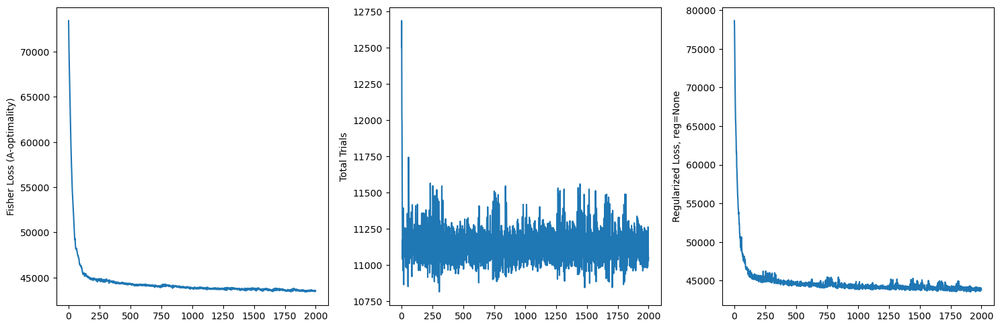

0.07619426264875101 0.07403152253920943


/tmp/ipykernel_68608/2421816399.py:117: RuntimeWarning: invalid value encountered in true_divide
  p_tmp = (p_new * T_new[np.newaxis, :, :] + probs_empirical * T_prev[np.newaxis, :, :]) / ((T_new + T_prev)[np.newaxis, :, :])


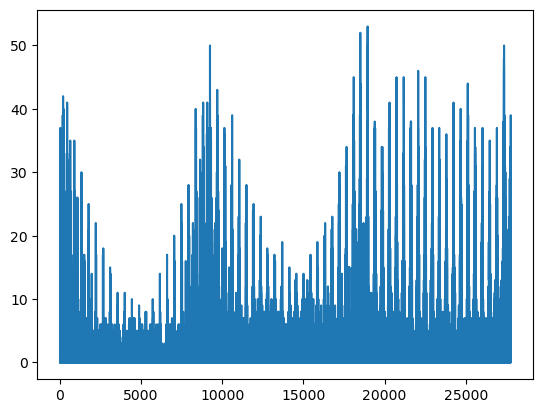

Setting up data...
Generating input list...
Fitting dataset...


/tmp/ipykernel_68608/2421816399.py:134: RuntimeWarning: invalid value encountered in true_divide
  p_tmp_uniform = (p_new_uniform * T_new_uniform[np.newaxis, :, :] + probs_empirical_uniform * T_prev_uniform[np.newaxis, :, :]) / ((T_prev_uniform + T_new_uniform)[np.newaxis, :, :])


Calculating Jacobian...
Optimizing trials...
0
(DeviceArray(39219.258, dtype=float32), DeviceArray(12502.086, dtype=float32), DeviceArray(41967.168, dtype=float32), DeviceArray(2747.909, dtype=float32))
1
(DeviceArray(39067.367, dtype=float32), DeviceArray(12582.916, dtype=float32), DeviceArray(41975.2, dtype=float32), DeviceArray(2907.8313, dtype=float32))
2
(DeviceArray(39009.375, dtype=float32), DeviceArray(12198.137, dtype=float32), DeviceArray(41155.92, dtype=float32), DeviceArray(2146.5457, dtype=float32))
3
(DeviceArray(39010.42, dtype=float32), DeviceArray(11609.001, dtype=float32), DeviceArray(39991.363, dtype=float32), DeviceArray(980.94135, dtype=float32))
4
(DeviceArray(39045.523, dtype=float32), DeviceArray(11461.175, dtype=float32), DeviceArray(39733.992, dtype=float32), DeviceArray(688.4674, dtype=float32))
5
(DeviceArray(39098.383, dtype=float32), DeviceArray(11119.611, dtype=float32), DeviceArray(39111.066, dtype=float32), DeviceArray(12.68442, dtype=float32))
6
(Devic

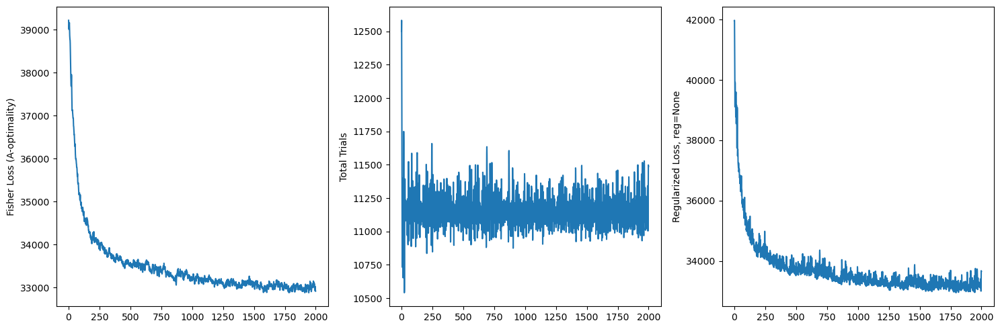

0.0668900309526756 0.07340799619710313


In [3]:
num_iters = 5

T_prev = np.zeros((amps_scan.shape[0], amps_scan.shape[1]), dtype=float)
budget = T_prev.shape[0] * T_prev.shape[1] * 0.5 #int(total_budget / num_iters)
reg = None # 20, 50
T_step_size = 0.05 # 0.05, 0.01
T_n_steps = 2000    # 5000

init_trials = 5
init_amps = 200
ms = [1, 2, 3, 4]
verbose = True
R2_cutoff = 0
exploit_factor = 0.8
entropy_samples = 1
trial_cap = 1000
min_prob = 1 / init_trials
error_rate_0 = 0.05
error_rate_1 = 0.1

for i in range(len(T_prev)):
    init_inds = np.random.choice(np.arange(len(T_prev[i]), dtype=int), size=init_amps,
                                 replace=False)
    T_prev[i][init_inds] = init_trials

T_prev_uniform = deepcopy(T_prev)

probs_empirical = cl.sample_spikes_array(probs_true_scan, T_prev, error_rate_0=error_rate_0,
                                         error_rate_1=error_rate_1, NUM_THREADS=24)
probs_empirical_uniform = deepcopy(probs_empirical)

performances = []
performances_uniform = []
num_samples = []
num_samples_uniform = []

iter_cnt = 0
while True:
    if iter_cnt == 0:
        T_new, w_inits_array, t_final, probs_curr, params_curr = cl.fisher_sampling(
                                        probs_empirical, 
                                        T_prev, amps_scan,
                                        T_step_size=T_step_size,
                                        T_n_steps=T_n_steps,
                                        verbose=verbose, budget=budget, ms=ms, reg=reg,
                                        return_probs=True,
                                        R2_cutoff=R2_cutoff,
                                        exploit_factor=exploit_factor, 
                                        entropy_samples=entropy_samples,
                                        trial_cap=trial_cap,
                                        min_prob=min_prob)
    
        performance = cl.get_performance_array(params_true, probs_curr, probs_true_scan)
        performance_uniform = performance

        w_inits_array_uniform = deepcopy(w_inits_array)
        
    else:
        T_new, w_inits_array, t_final, probs_curr, params_curr = cl.fisher_sampling(
                                        probs_empirical, 
                                        T_prev, amps_scan,
                                        T_step_size=T_step_size,
                                        T_n_steps=T_n_steps,
                                        verbose=verbose, budget=budget, ms=ms, reg=reg,
                                        return_probs=True,
                                        w_inits_array=w_inits_array,
                                        R2_cutoff=R2_cutoff,
                                        exploit_factor=exploit_factor,
                                        entropy_samples=entropy_samples,
                                        trial_cap=trial_cap,
                                        min_prob=min_prob)

        
        performance = cl.get_performance_array(params_true, probs_curr, probs_true_scan)

        input_list_uniform = cl.generate_input_list(probs_empirical_uniform, amps_scan, 
                                                            T_prev_uniform, w_inits_array_uniform)

        pool = mp.Pool(processes=24)
        results_uniform = pool.starmap_async(fitting.fit_surface, input_list_uniform)
        mp_output_uniform = results_uniform.get()
        pool.close()

        params_curr_uniform = np.zeros((probs_empirical_uniform.shape[0], probs_empirical_uniform.shape[1]), dtype=object)
        w_inits_array_uniform = np.zeros((probs_empirical_uniform.shape[0], probs_empirical_uniform.shape[1]), dtype=object)
        probs_curr_uniform = np.zeros(probs_empirical_uniform.shape)

        cnt = 0
        for i in range(len(probs_empirical_uniform)):
            for j in range(len(probs_empirical_uniform[i])):
                params_curr_uniform[i][j] = mp_output_uniform[cnt][0][0]
                w_inits_array_uniform[i][j] = mp_output_uniform[cnt][1]
                
                probs_curr_uniform[i][j] = fitting.sigmoidND_nonlinear(
                                        sm.add_constant(amps_scan[j], has_constant='add'), 
                                        params_curr_uniform[i][j])

                cnt += 1

        performance_uniform = cl.get_performance_array(params_true, probs_curr_uniform, probs_true_scan)
    
    print(performance, performance_uniform)
    
    performances.append(performance)
    performances_uniform.append(performance_uniform)
    
    num_samples.append(np.sum(T_prev))
    num_samples_uniform.append(np.sum(T_prev_uniform))

    iter_cnt += 1

    if iter_cnt > num_iters:
        break

    p_new = cl.sample_spikes_array(probs_true_scan, T_new, error_rate_0=error_rate_0,
                                   error_rate_1=error_rate_1, NUM_THREADS=24)
    p_tmp = (p_new * T_new[np.newaxis, :, :] + probs_empirical * T_prev[np.newaxis, :, :]) / ((T_new + T_prev)[np.newaxis, :, :])
    T_tmp = T_new + T_prev

    p_tmp = np.nan_to_num(p_tmp, nan=0.5)

    probs_empirical = p_tmp
    T_prev = T_tmp

    plt.figure()
    plt.plot(T_prev.flatten())
    plt.show()
    
    random_extra = np.random.choice(len(T_new.flatten()), size=int(np.sum(T_new)), replace=True)
    T_new_uniform = np.array(np.bincount(random_extra, minlength=len(T_new.flatten())).astype(int).reshape(T_new.shape), dtype=float)
    p_new_uniform = cl.sample_spikes_array(probs_true_scan, T_new_uniform, error_rate_0=error_rate_0,
                                           error_rate_1=error_rate_1, NUM_THREADS=24)

    p_tmp_uniform = (p_new_uniform * T_new_uniform[np.newaxis, :, :] + probs_empirical_uniform * T_prev_uniform[np.newaxis, :, :]) / ((T_prev_uniform + T_new_uniform)[np.newaxis, :, :])
    T_tmp_uniform = T_prev_uniform + T_new_uniform

    p_tmp_uniform = np.nan_to_num(p_tmp_uniform, nan=0.5)

    probs_empirical_uniform = p_tmp_uniform
    T_prev_uniform = T_tmp_uniform

In [4]:
baseline_trials = 20
T_prev_baseline = np.ones_like(T_prev, dtype=float) * baseline_trials

probs_empirical_baseline = cl.sample_spikes_array(probs_true_scan, T_prev_baseline, error_rate_0=error_rate_0,
                                                  error_rate_1=error_rate_1, NUM_THREADS=48)

w_inits_array_baseline = np.zeros((probs_empirical_baseline.shape[0], probs_empirical_baseline.shape[1]), dtype=object)
for i in range(len(w_inits_array_baseline)):
    for j in range(len(w_inits_array_baseline[i])):
        w_inits = []

        for m in ms:
            w_init = np.array(np.random.normal(size=(m, amps_scan[j].shape[1]+1)))
            w_inits.append(w_init)

        w_inits_array_baseline[i][j] = w_inits

input_list_baseline = cl.generate_input_list(probs_empirical_baseline, amps_scan, T_prev_baseline, w_inits_array_baseline, min_prob=1 / baseline_trials)

pool = mp.Pool(processes=24)
results_baseline = pool.starmap_async(fitting.fit_surface, input_list_baseline)
mp_output_baseline = results_baseline.get()
pool.close()

params_curr_baseline = np.zeros((probs_empirical_baseline.shape[0], probs_empirical_baseline.shape[1]), dtype=object)
w_inits_array_baseline = np.zeros((probs_empirical_baseline.shape[0], probs_empirical_baseline.shape[1]), dtype=object)
probs_curr_baseline = np.zeros(probs_empirical_baseline.shape)

cnt = 0
for i in range(len(probs_empirical_baseline)):
    for j in range(len(probs_empirical_baseline[i])):
        params_curr_baseline[i][j] = mp_output_baseline[cnt][0][0]
        w_inits_array_baseline[i][j] = mp_output_baseline[cnt][1]
        
        probs_curr_baseline[i][j] = fitting.sigmoidND_nonlinear(
                                sm.add_constant(amps_scan[j], has_constant='add'), 
                                params_curr_baseline[i][j])

        cnt += 1

performance_baseline = cl.get_performance_array(params_true, probs_curr_baseline, probs_true_scan)

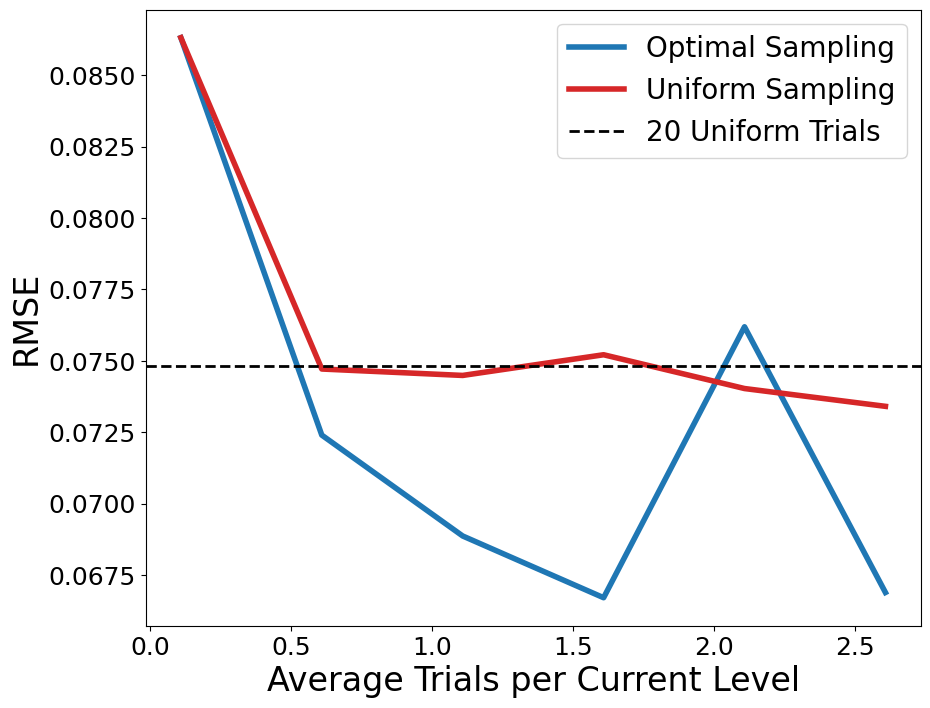

In [5]:
plt.figure(figsize=(10, 8))

plt.plot(np.array(num_samples)/T_prev.shape[0]/T_prev.shape[1], performances, linewidth=4, c='tab:blue', label='Optimal Sampling')
plt.plot(np.array(num_samples_uniform)/T_prev_uniform.shape[0]/T_prev_uniform.shape[1], performances_uniform, linewidth=4, c='tab:red', label='Uniform Sampling')

plt.axhline(performance_baseline, c='k', linestyle='--', linewidth=2, label=f'{baseline_trials} Uniform Trials')
plt.xticks(fontsize=18)
plt.yticks(fontsize=18)
plt.xlabel('Average Trials per Current Level', fontsize=24)
plt.ylabel(r'RMSE', fontsize=24)
plt.legend(fontsize=20)

# plt.savefig(f'triplet_AL_fakedata_{DATASET}.png', dpi=300)

[[-8.0406007  -1.37263637 -6.58856452 -1.63285575]
 [-8.67546505  1.32780148  5.7802818   1.5797134 ]]


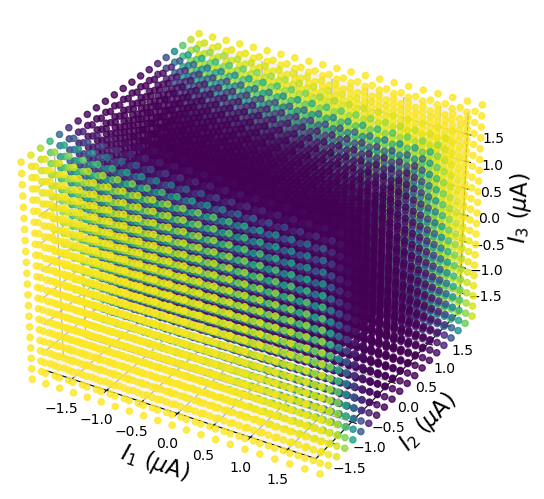

[[-5.29078277  0.76293737  3.35405853  0.91656517]
 [-5.29078277 -0.82739707 -4.15423594 -0.99214008]]


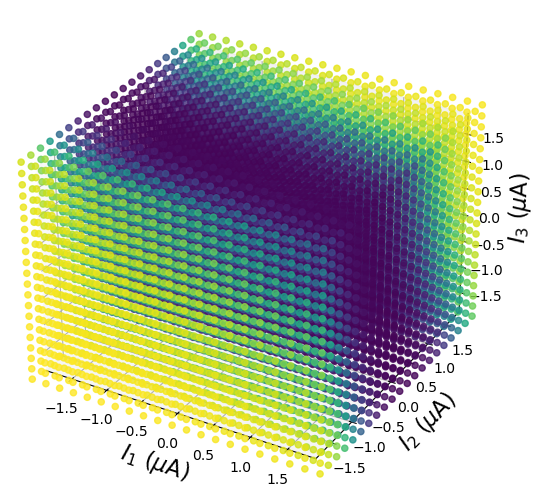

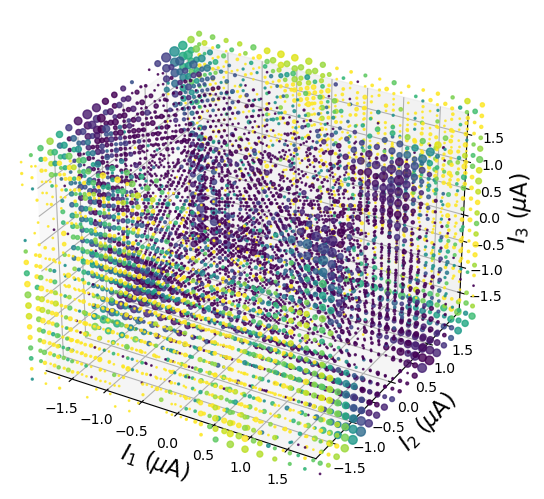

[[-5.29078277  0.76763175  3.43264762  0.90061523]
 [-5.29078277 -0.87996732 -4.15293752 -0.9730573 ]]


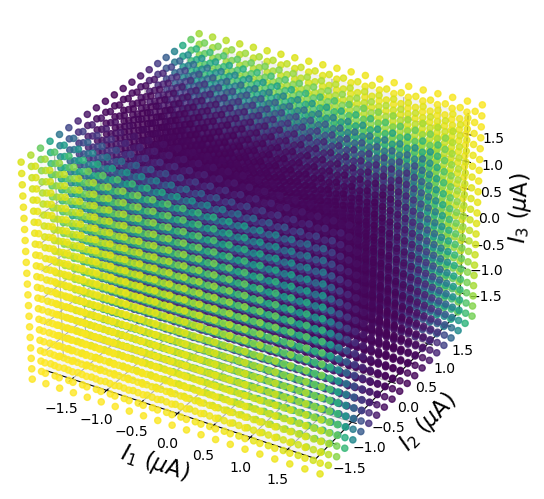

[[-5.37292742  2.61449346  2.55321048  0.75949937]
 [-5.31203262 -2.86430292 -2.86907028 -1.06419633]]


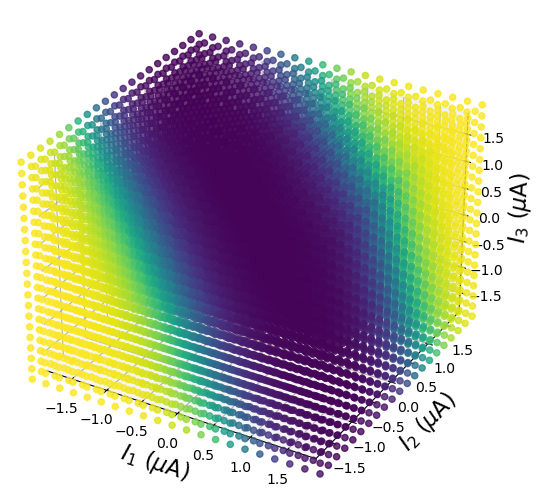

[[-5.29078277 -2.62363341 -2.7184699  -0.95533332]
 [-5.29078277  2.4688334   2.31001009  0.71639442]]


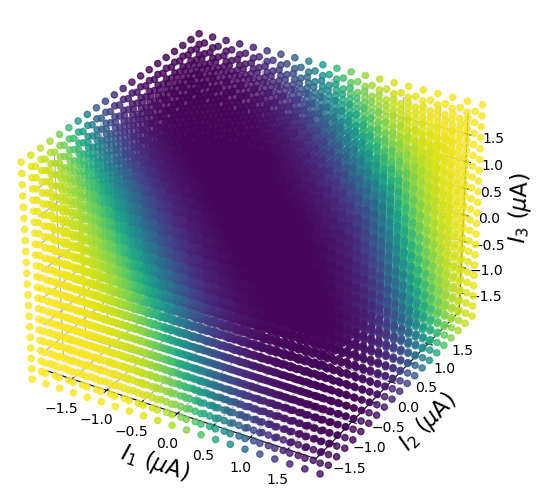

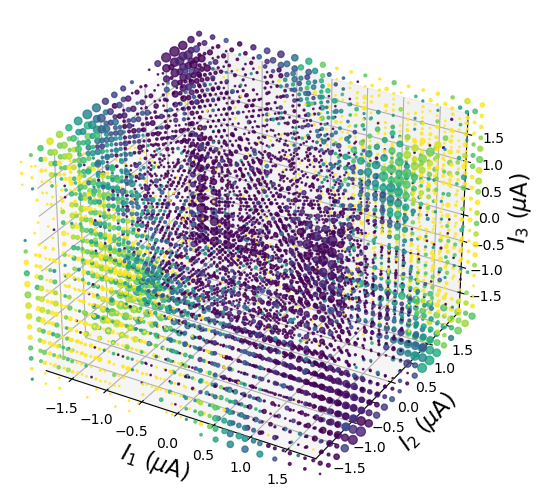

[[-5.29078277 -2.70154031 -2.71659266 -0.90791625]
 [-5.29078277  2.44108383  2.46784254  0.65789565]]


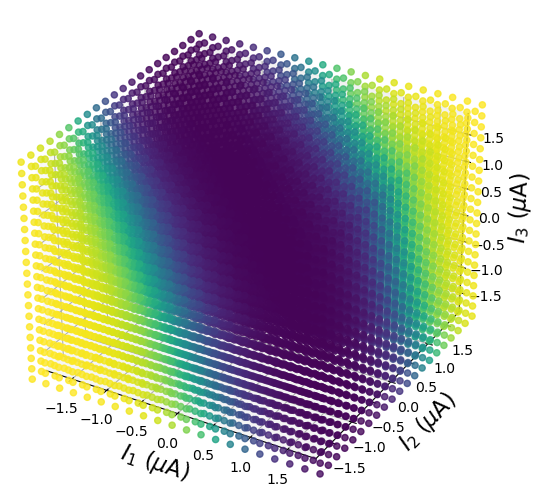

[[ -8.8412545   -4.38160658 -11.66847276  -2.50428948]
 [-11.62768176   5.22074454  12.93914655   2.87665552]]


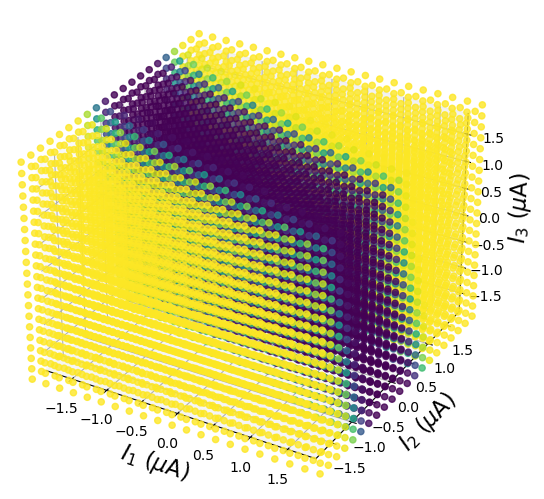

[[-5.29078277 -2.03704041 -5.85005565 -1.22464531]
 [-5.29078277  2.03046807  5.24655409  1.15052588]]


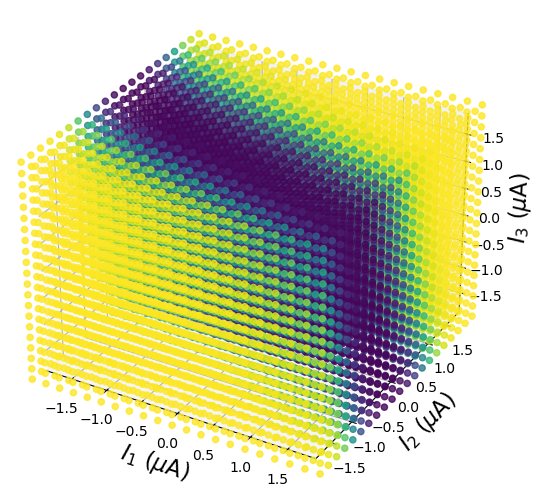

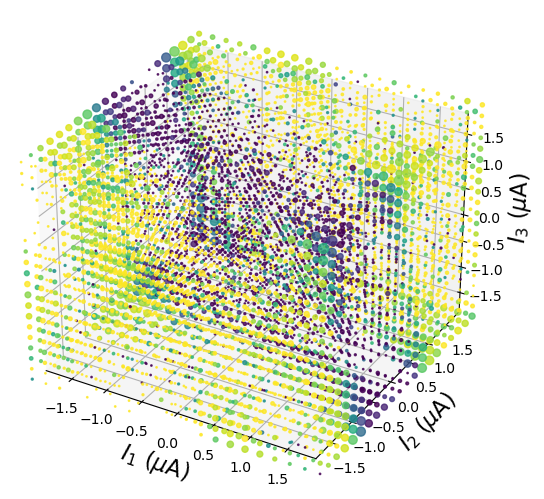

[[-5.29078277 -1.98047476 -5.7513924  -1.1102217 ]
 [-5.29078277  1.93860486  5.17057979  1.03204748]]


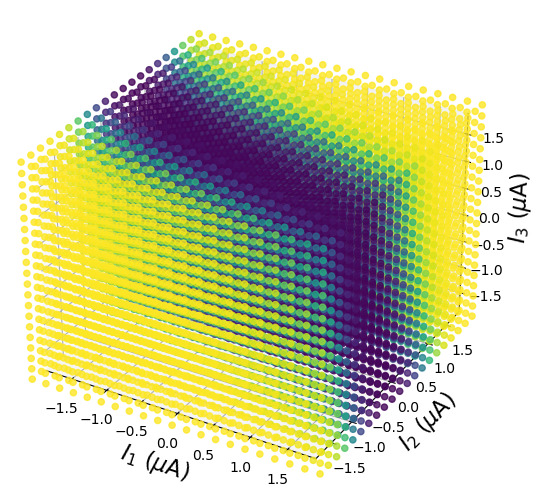

[[-7.44715494 -3.28343616 -2.67641243 -2.08948162]
 [-7.11480471  3.07189962  2.31864058  1.99345444]]


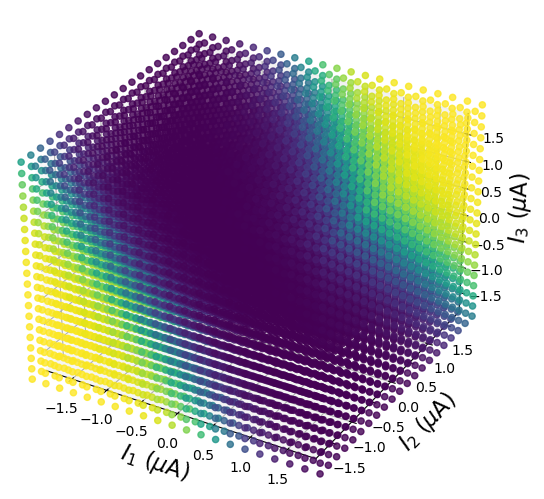

[[-5.29078277 -2.29119492 -1.77793913 -1.43208064]
 [-5.29078277  2.25870221  1.61094327  1.40082753]]


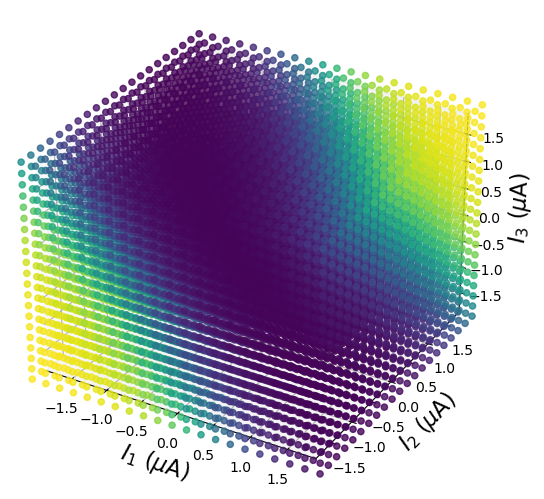

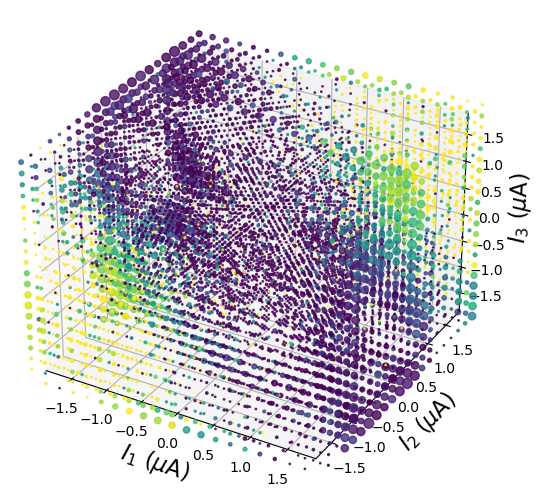

[[-5.29078277 -2.2730281  -1.7954435  -1.4017642 ]
 [-5.29078277  2.28844214  1.60802549  1.44017351]]


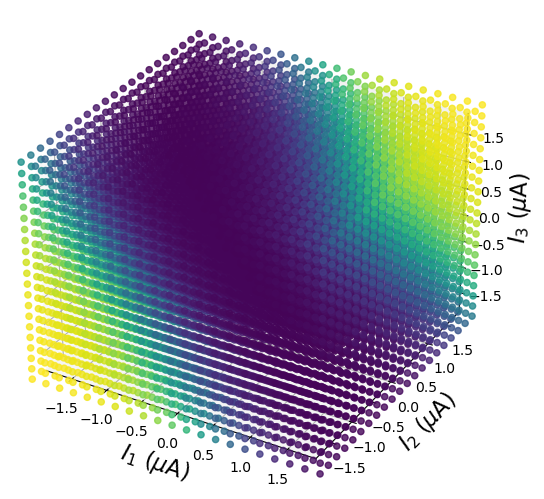

[[-6.24044925  1.41216627  1.07709724  2.01552819]
 [-5.53965818 -1.58075983 -1.08807628 -1.96534989]]


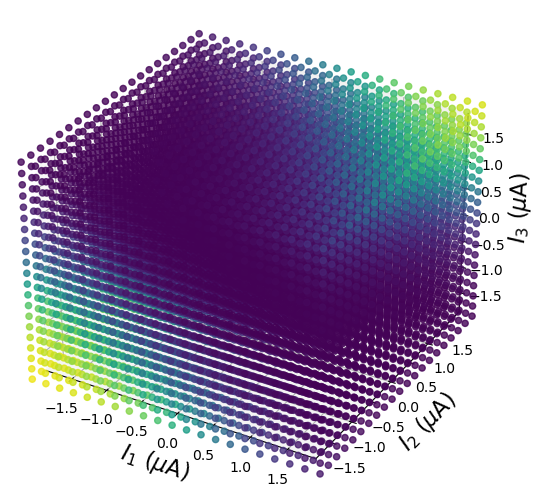

[[-5.69708599  1.04103689  0.90720881  2.04061897]
 [-5.69708599  1.38786267 -0.17820163 -0.24252587]
 [-5.69708599 -1.80344757 -0.98687661 -1.83307825]]


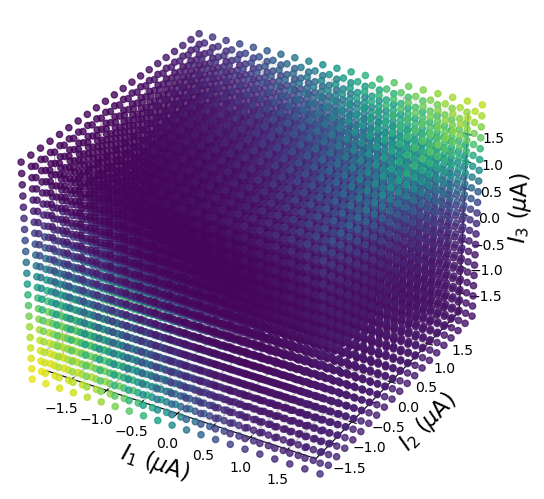

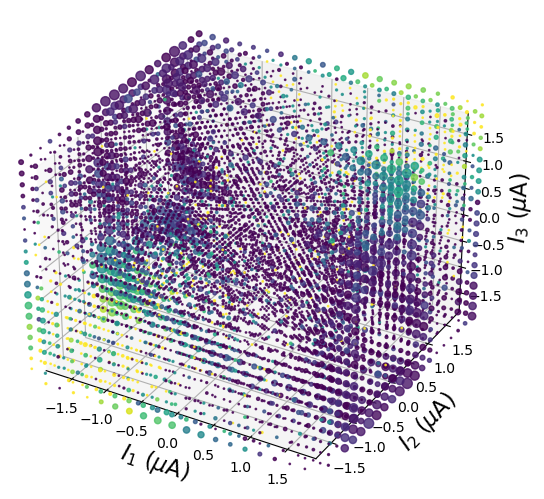

[[-5.98518703 -2.17680709 -0.30431435 -0.54802269]
 [-5.98518703 -1.18710651 -1.08610311 -2.22875608]
 [-5.98518703  1.97629085  0.32681477  0.17889627]
 [-5.98518703  0.96077782  0.92772414  2.18930369]]


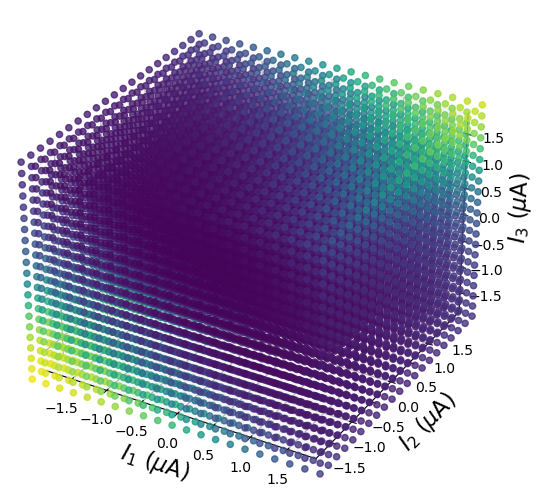

[[-7.30118334  1.77203961  1.64622081  1.82217088]
 [-8.73242342 -2.21656286 -1.58365136 -2.68725881]]


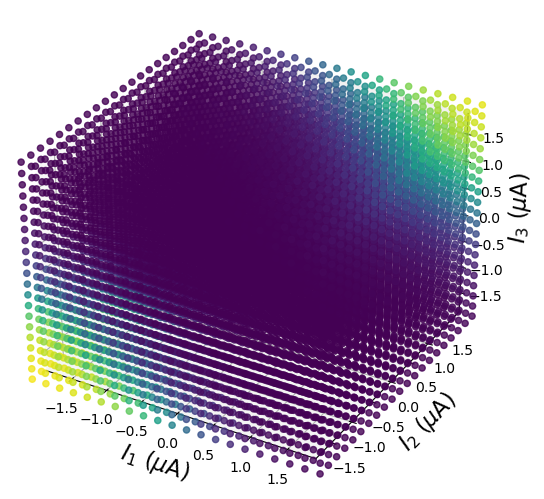

[[-5.69708599  1.41317687 -0.01634132 -0.13881145]
 [-5.69708599  1.05670921  1.26638275  1.58619607]
 [-5.69708599 -1.56379902 -1.03947105 -1.49300463]]


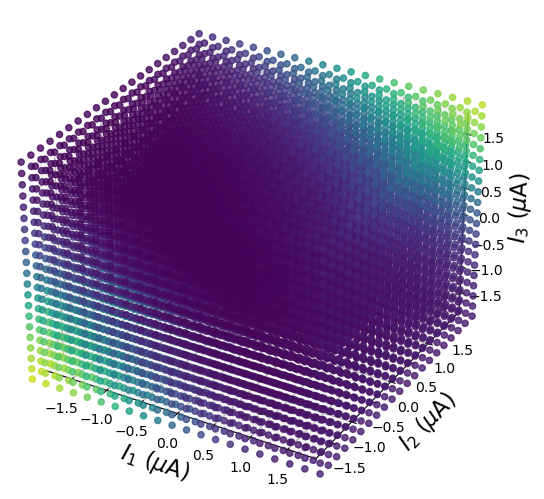

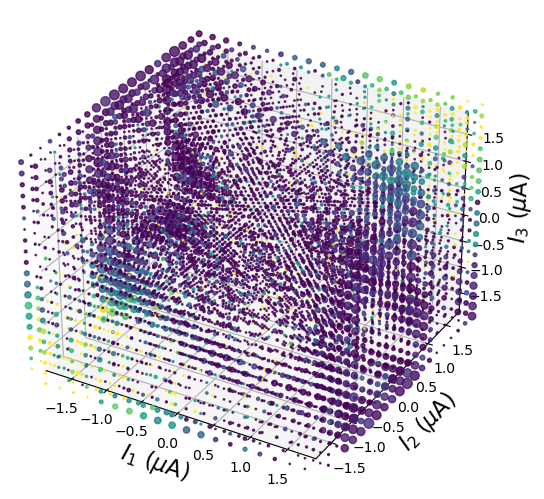

[[-5.69708599  0.85657475  1.15131308  1.757763  ]
 [-5.69708599  1.74457074  0.31704661  0.07391787]
 [-5.69708599 -1.60234562 -0.98763385 -1.47069495]]


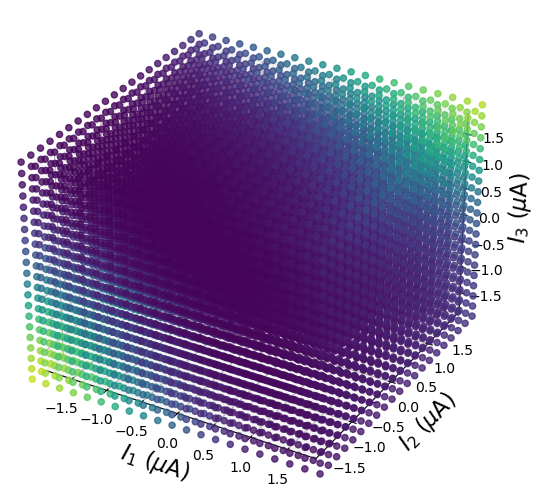

[[-11.35625418   2.79323378   5.71826217   3.2569141 ]
 [ -8.76211992  -1.88048833  -2.37309664  -1.96570568]]


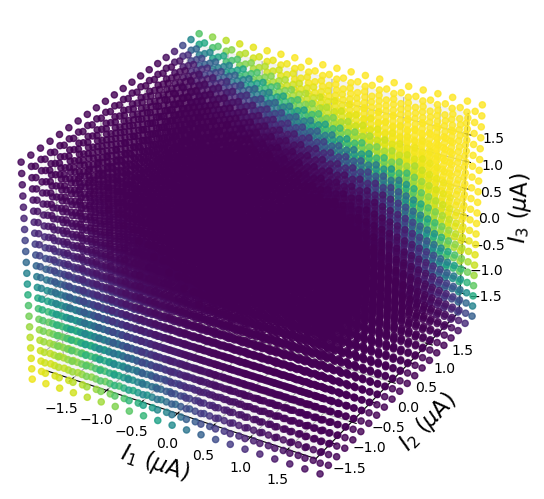

[[-5.29078277 -0.97834773 -1.54346584 -1.13782237]
 [-5.29078277  1.255364    2.49934158  1.38185247]]


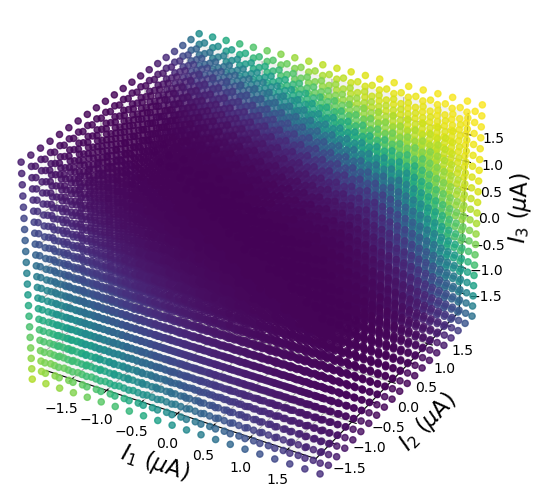

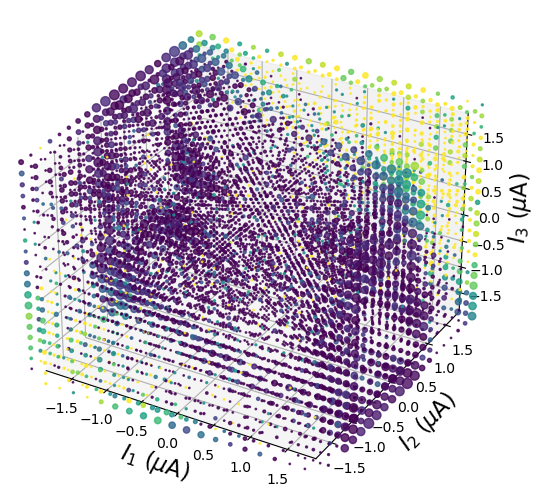

[[-5.29078277 -0.97105389 -1.49012564 -1.07230511]
 [-5.29078277  1.31014867  2.52906903  1.49772398]]


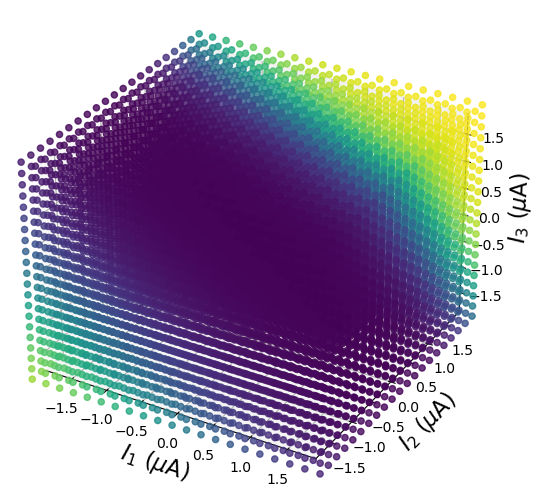

[[-12.39862656   5.03642217   0.23196829   1.04365563]
 [-20.62272168 -12.37423793   0.8596747   -1.29104566]]


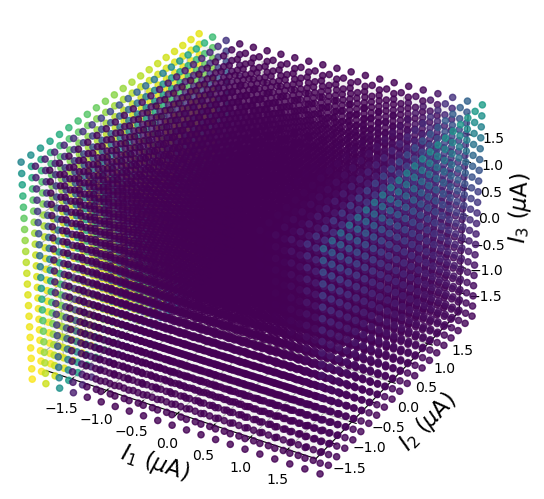

[[-5.29078277  1.82332761  0.12839649  0.47184585]
 [-7.05096757 -4.19242997  0.32081395 -0.47406703]]


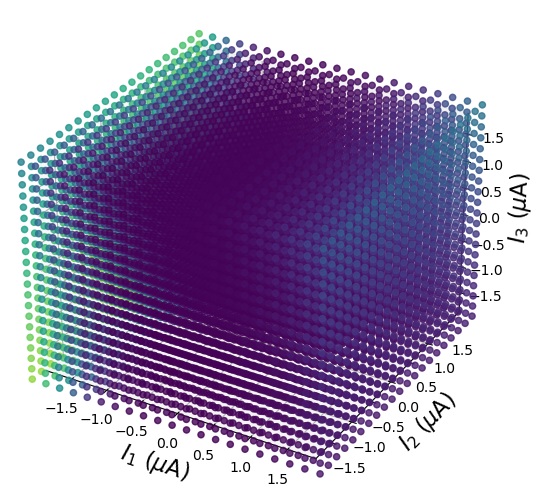

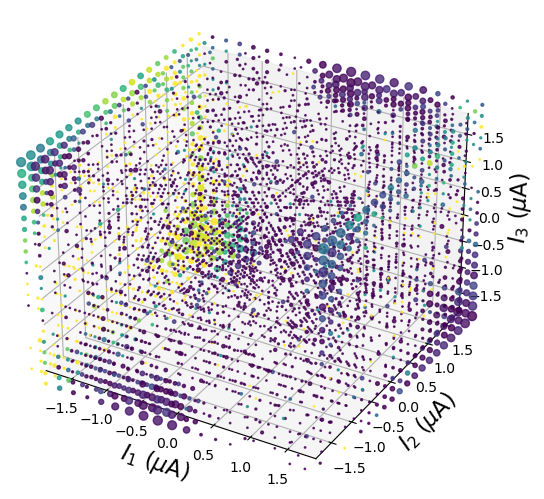

[[ -5.98518703  -0.2569806   -1.6274057   -0.27936926]
 [ -5.98518703   2.08263279   0.11736121   0.56872644]
 [ -5.98518703  -0.54685508   1.68937148  -0.05608107]
 [-12.76630946  -7.45031522   0.54052319  -0.7636833 ]]


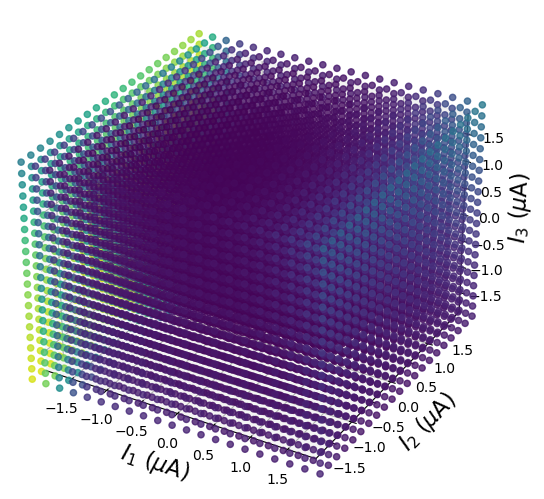

[[ -5.98518703  -2.17511096  -9.20359928   0.03259289]
 [-11.0140138    0.78993197  -2.85750159   6.30384516]
 [ -8.86988938   3.33611126  11.19799292   1.04960371]
 [ -8.82089175  -0.74845048   1.41281506  -5.55627729]]


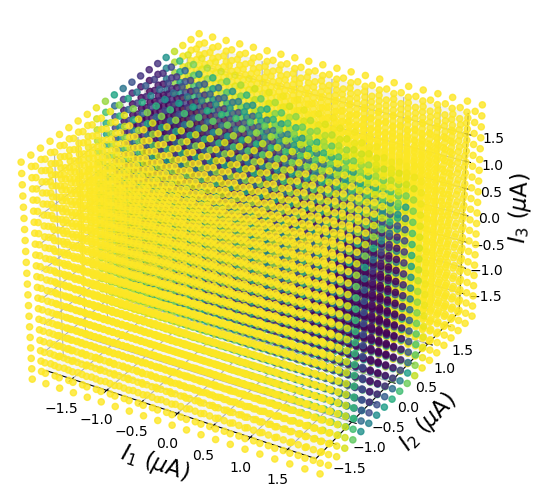

[[-5.98518703 -1.70490025 -7.38323732 -0.10949118]
 [-5.98518703  1.90156195  6.49741639  0.64013023]
 [-5.98518703 -0.54810392  0.78234773 -3.65238136]
 [-5.98518703  0.47598548 -1.35494699  3.37218084]]


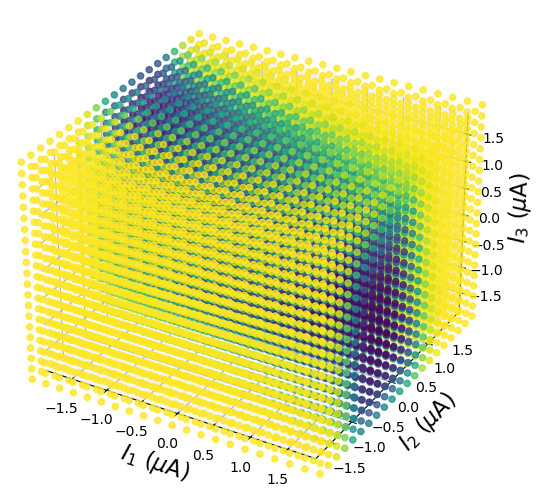

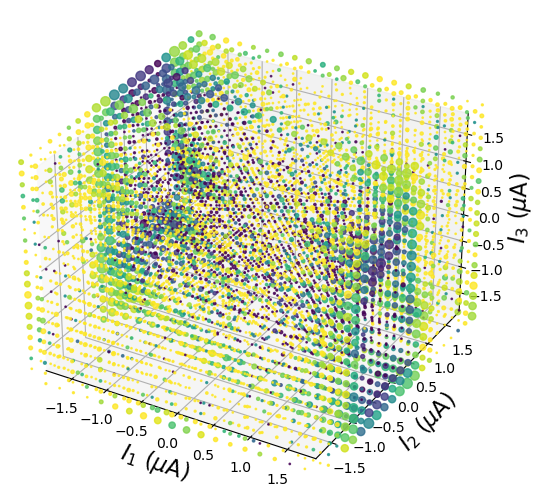

[[-5.98518703 -1.32245895 -5.924996   -0.46550808]
 [-5.98518703  1.44220647  5.70799927  0.74375481]
 [-5.98518703 -0.44902109  0.76585465 -3.70557589]
 [-5.98518703  0.47391361 -1.10597425  3.44768707]]


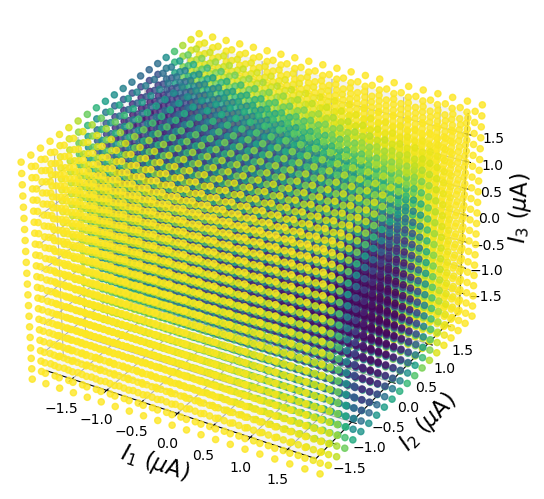

[[-5.82585198 -3.44021287 -1.14987877 -1.17845257]
 [-5.29078277  2.66484893  1.07291609  0.88849777]]


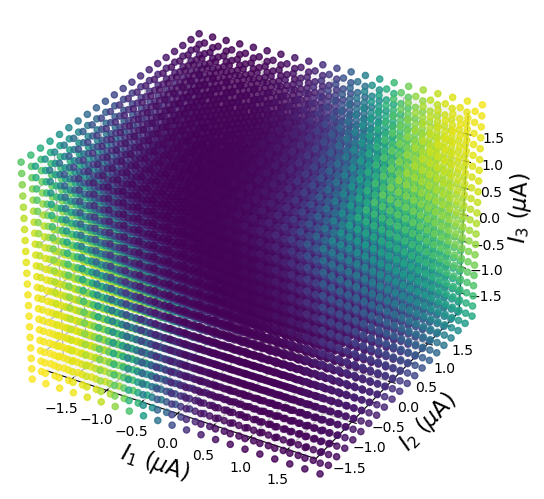

[[-5.29078277 -3.04184549 -0.9842382  -1.01670982]
 [-5.29078277  2.63264646  1.01875346  0.88154669]]


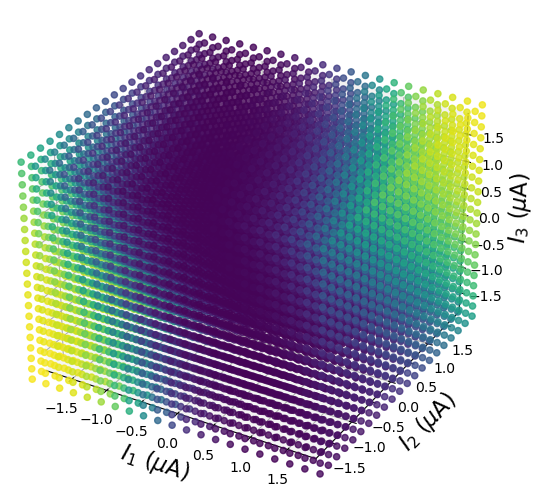

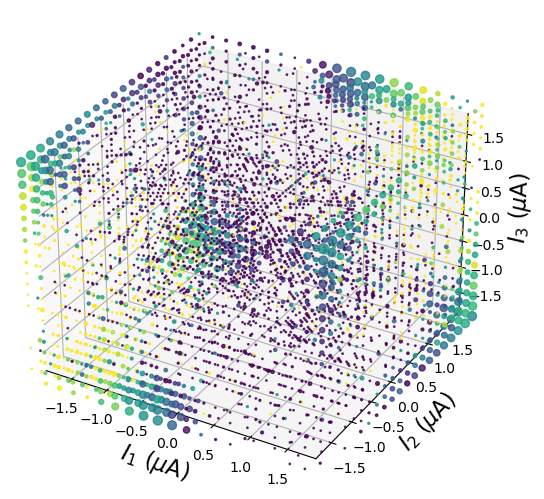

[[-5.29078277 -3.07863433 -0.93038674 -1.02698923]
 [-5.29078277  2.69072259  0.97398297  0.82772618]]


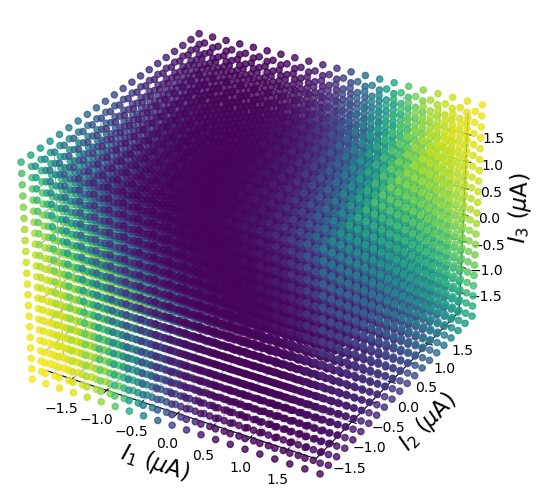

[[ -9.27310304   0.69044044   2.1187062    3.19115565]
 [-10.96818578  -0.58032638  -2.86907317  -4.49612368]]


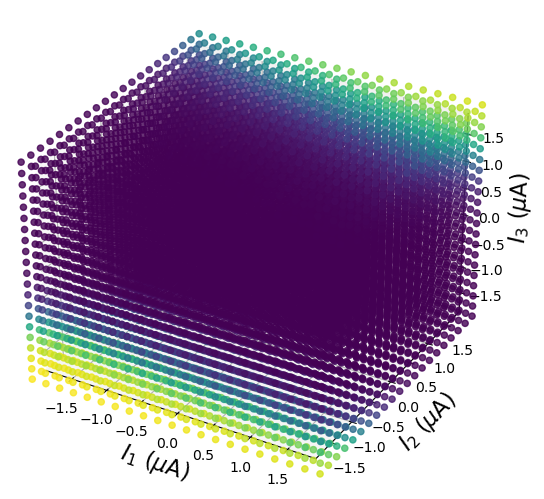

[[-5.29078277  0.34708596  1.01478674  1.78043081]
 [-5.29078277 -0.2543753  -1.365374   -2.05050778]]


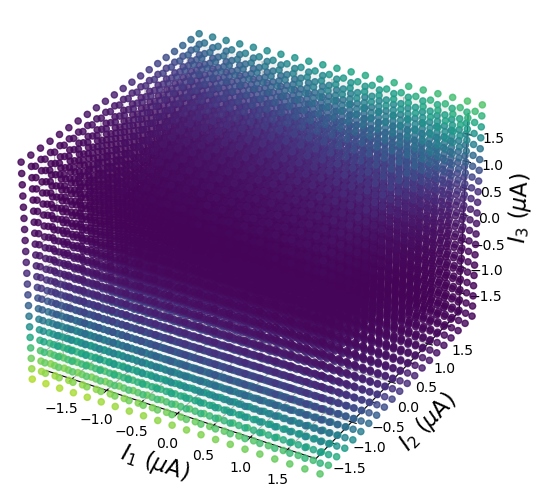

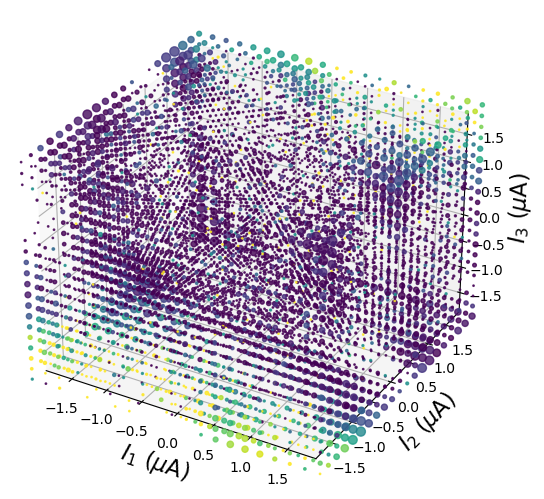

[[-5.69708599 -0.25022271 -1.61738319 -2.09297578]
 [-5.69708599  0.38242798  0.87796878  2.0999214 ]
 [-5.69708599  0.08936945  1.41986199 -0.31436078]]


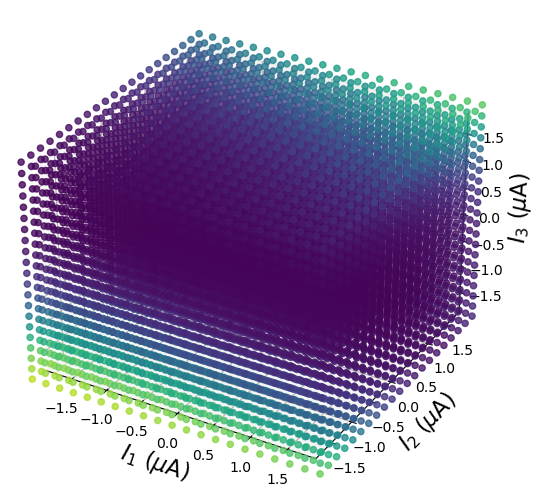

In [6]:
# CHECK DATASET IF NEEDED
from mpl_toolkits.mplot3d import Axes3D

for i in range(len(probs_true_scan)):
    for j in range(len(probs_true_scan[i])):
        if type(params_true[i][j]) != int:

            print(params_true[i][j])
            sampled_inds = np.where(T_prev[j] > 0)[0]
            
            fig = plt.figure(0)
            fig.clear()
            ax = Axes3D(fig, auto_add_to_figure=False)
            fig.add_axes(ax)
            plt.xlabel(r'$I_1$ ($\mu$A)', fontsize=16)
            plt.ylabel(r'$I_2$ ($\mu$A)', fontsize=16)
            plt.xlim(-1.8, 1.8)
            plt.ylim(-1.8, 1.8)
            ax.set_zlim(-1.8, 1.8)
            ax.set_zlabel(r'$I_3$ ($\mu$A)', fontsize=16)

            scat = ax.scatter(amps_scan[j][:, 0], 
                              amps_scan[j][:, 1],
                              amps_scan[j][:, 2], marker='o', 
                              c=probs_true_scan[i][j], s=20, alpha=0.8, vmin=0, vmax=1)
            plt.show()


            print(params_curr[i][j])
            fig = plt.figure(1)
            fig.clear()
            ax = Axes3D(fig, auto_add_to_figure=False)
            fig.add_axes(ax)
            plt.xlabel(r'$I_1$ ($\mu$A)', fontsize=16)
            plt.ylabel(r'$I_2$ ($\mu$A)', fontsize=16)
            plt.xlim(-1.8, 1.8)
            plt.ylim(-1.8, 1.8)
            ax.set_zlim(-1.8, 1.8)
            ax.set_zlabel(r'$I_3$ ($\mu$A)', fontsize=16)

            scat = ax.scatter(amps_scan[j][:, 0], 
                              amps_scan[j][:, 1],
                              amps_scan[j][:, 2], marker='o', 
                              c=probs_curr[i][j], s=20, alpha=0.8, vmin=0, vmax=1)
            plt.show()

            fig = plt.figure(1)
            fig.clear()
            ax = Axes3D(fig, auto_add_to_figure=False)
            fig.add_axes(ax)
            plt.xlabel(r'$I_1$ ($\mu$A)', fontsize=16)
            plt.ylabel(r'$I_2$ ($\mu$A)', fontsize=16)
            plt.xlim(-1.8, 1.8)
            plt.ylim(-1.8, 1.8)
            ax.set_zlim(-1.8, 1.8)
            ax.set_zlabel(r'$I_3$ ($\mu$A)', fontsize=16)

            scat = ax.scatter(amps_scan[j][sampled_inds, 0], 
                              amps_scan[j][sampled_inds, 1],
                              amps_scan[j][sampled_inds, 2], marker='o', 
                              c=probs_empirical[i][j][sampled_inds], 
                              s=T_prev[j][sampled_inds], alpha=0.8, vmin=0, vmax=1)
            plt.show()

            print(params_curr_uniform[i][j])
            fig = plt.figure(1)
            fig.clear()
            ax = Axes3D(fig, auto_add_to_figure=False)
            fig.add_axes(ax)
            plt.xlabel(r'$I_1$ ($\mu$A)', fontsize=16)
            plt.ylabel(r'$I_2$ ($\mu$A)', fontsize=16)
            plt.xlim(-1.8, 1.8)
            plt.ylim(-1.8, 1.8)
            ax.set_zlim(-1.8, 1.8)
            ax.set_zlabel(r'$I_3$ ($\mu$A)', fontsize=16)

            scat = ax.scatter(amps_scan[j][:, 0], 
                              amps_scan[j][:, 1],
                              amps_scan[j][:, 2], marker='o', 
                              c=probs_curr_uniform[i][j], s=20, alpha=0.8, vmin=0, vmax=1)
            plt.show()

            input()